# Question 1: Explain how to call the Scene component of the ray tracer using the Sionna Python package.

In [1]:
# Import the necessary module
import sionna

# Import the function to load scenes
from sionna.rt import load_scene, Scene

# Load an example scene
scene = load_scene(sionna.rt.scene.etoile)

# If the scene name variable is not predefined and directly accessible,
# you could instead navigate through the sionna.rt module based on the
# structure of the Sionna package. This detail is assumed from
# the example usage pattern and might need adjustment based on the
# actual package structure and naming conventions.
scene.preview()

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, position=(0.0, 0.0, …

# Question 2: I have installed sionna. How to perform raytracing?

In [2]:
from sionna.rt import load_scene, Transmitter, Receiver, PlanarArray
# Load an example scene (e.g., Munich scene)
scene = load_scene(sionna.rt.scene.munich)
scene.tx_array = PlanarArray(num_rows=8, 
                            num_cols=2,
                            vertical_spacing=0.7,
                            horizontal_spacing=0.5,
                            pattern="tr38901",
                            polarization="VH")
# Configure antenna array for all receivers in the scene
scene.rx_array = PlanarArray(num_rows=1,
                             num_cols=1,
                             vertical_spacing=0.5,
                             horizontal_spacing=0.5,
                             pattern="dipole",
                             polarization="cross")
tx = Transmitter(name="tx",
                 position=[8.5, 21, 27],
                 orientation=[0, 0, 0])
scene.add(tx)
# Create a receiver object and add it to the scene
rx = Receiver(name="rx",
              position=[45, 90, 1.5],
              orientation=[0, 0, 0])
scene.add(rx)
# Compute paths with specific parameters
paths = scene.compute_paths(max_depth=3,
                            method="fibonacci",
                            num_samples=int(1e6),
                            los=True,
                            reflection=True,
                            diffraction=False,
                            scattering=False,
                            check_scene=True)
scene.preview(paths=paths, resolution=[1000, 600])

Renderer(camera=PerspectiveCamera(aspect=1.6666666666666667, children=(DirectionalLight(intensity=0.25, positi…

# Question 3: How to compute the impulse response accordingly?

In [3]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

In [4]:
a, tau = paths.cir()
# Provided compute_gain function
def compute_gain(a, tau):
    """Compute |H(f)|^2 at f = 0 where H(f) is the baseband channel frequency response"""
    a = tf.squeeze(a, axis=-1)
    h_f_2 = tf.math.abs(tf.reduce_sum(a, axis=-1))**2
    h_f_2 = tf.where(h_f_2==0, 1e-24, h_f_2)
    g_db = 10*np.log10(h_f_2)
    return tf.squeeze(g_db)


In [5]:
a.shape

TensorShape([1, 1, 2, 1, 32, 11, 1])

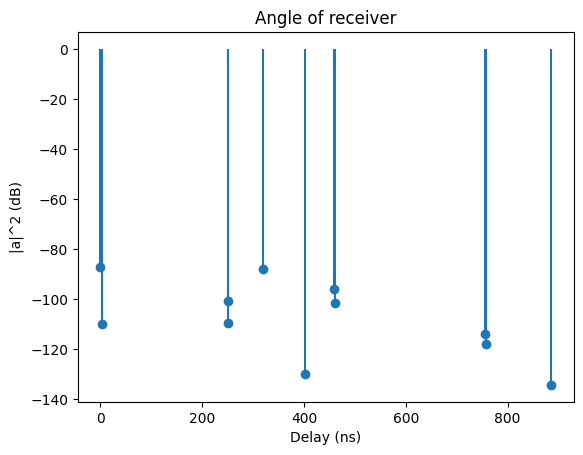

In [6]:
n = 400
plt.figure()
plt.stem(tau[0,0,0,:]/1e-9, 10*np.log10(np.abs(a[0,0,0,0,0,:,0])**2), basefmt=" ")
plt.title(f"Angle of receiver")
plt.xlabel("Delay (ns)")
plt.ylabel("|a|^2 (dB)")
plt.show()

# # Example usage of compute_gain (optional here) for receiver at index n
# g_db_n = compute_gain(a[n:n+1], tau[n:n+1])
# print(f"Computed gain for the receiver {n}: {g_db_n.numpy()} dB")

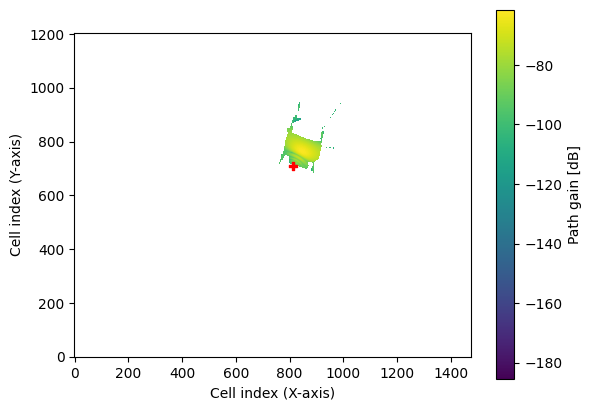

In [7]:
import sionna
from sionna.rt import load_scene, PlanarArray, Transmitter, Receiver, Camera
# Assuming you have the Sionna package installed and the necessary dependencies,
# load the Munich scene from the Sionna Ray Tracing module
scene = load_scene(sionna.rt.scene.munich)
# Configure the antenna array for all transmitters
scene.tx_array = PlanarArray(num_rows=8,
                             num_cols=2,
                             vertical_spacing=0.7,
                             horizontal_spacing=0.5,
                             pattern="tr38901",
                             polarization="VH")
# Configure the antenna array for all receivers
scene.rx_array = PlanarArray(num_rows=1,
                             num_cols=1,
                             vertical_spacing=0.5,
                             horizontal_spacing=0.5,
                             pattern="dipole",
                             polarization="cross")
# Add a transmitter
tx = Transmitter(name="tx",
                 position=[8.5, 21, 30],  # Position adjusted for the example
                 orientation=[0, 0, 0])
scene.add(tx)
tx.look_at([40, 80, 1.5])
# Compute the coverage map with specified parameters
cm = scene.coverage_map(cm_cell_size=[1.,1.],  # Size of each cell in meters
                        num_samples=int(10e6))  # Number of rays to trace
# Fit the camera to view the whole scene. This step configures the camera
# for visualization and is adapted from the context to fit within this example
tx_pos = scene.transmitters["tx"].position.numpy()
bird_pos = tx_pos.copy()
bird_pos[-1] += 100  # Height above the transmitter
scene.add(Camera("birds_view", position=bird_pos, look_at=tx_pos))
# Visualize the coverage map in 2D for the first transmitter
cm.show(tx=0)

In [8]:
# Open 3D preview (only works in Jupyter notebook)
scene.preview(coverage_map=cm)

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, position=(0.0, 0.0, …